In [144]:
from sklearn.cluster import MeanShift, estimate_bandwidth, DBSCAN
import numpy as np
import pandas as pd
import cv2 as cv
from matplotlib import pyplot as plt
from itertools import cycle
from sklearn.metrics import silhouette_score
import os
import shutil
from gensim.models.word2vec import Word2Vec
from nltk.tokenize import word_tokenize, sent_tokenize
import nltk


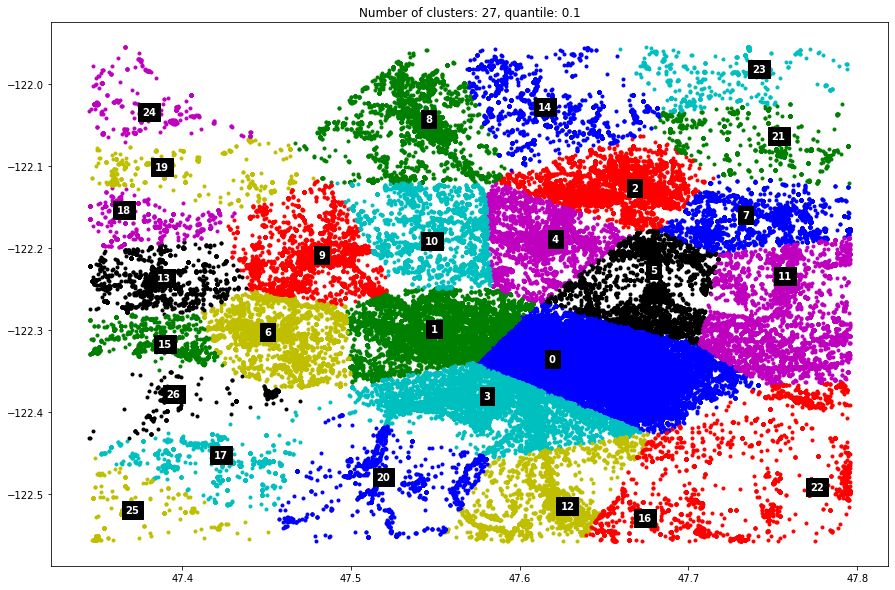

Silhouette Score : 0.46726960871486806


In [124]:
# phase 1
photos = pd.read_csv('./Photo.csv', header=0, names= ['photo_id', 'user_id', 'latitude', 'longitude', 'time', 'etc'])
coordinate = photos[['latitude', 'longitude']]
quantile = 0.1
bandwidth = estimate_bandwidth(coordinate, quantile=quantile, n_samples=1000, n_jobs=-1)
cluster = MeanShift(bandwidth = bandwidth, bin_seeding=True, n_jobs = -1).fit(coordinate)

labels = cluster.labels_
cluster_centers = cluster.cluster_centers_

labels_unique = np.unique(labels)
num_clusters = len(labels_unique) - 1
plt.figure(figsize=(15, 10))
plt.clf()
colors = cycle('bgrcmkybgrcmykbgrcmybgrcmyk')
for k, col in zip(range(num_clusters), colors):
    my_members = labels == k
    cluster_center = cluster_centers[k]
    plt.plot(coordinate['latitude'][my_members], coordinate['longitude'][my_members], col + '.')
    plt.annotate(k, xy=(cluster_center[0], cluster_center[1]), color='white', backgroundcolor=(0.0, 0.0, 0.0), size=10, weight='bold') # annotate each cluster
plt.title(f'Number of clusters: {num_clusters}, quantile: {quantile}')
plt.show()

# get silhouette score
score = silhouette_score(coordinate, labels, sample_size=10000)
print(f'Silhouette Score : {score}')



In [125]:
# match photo id with label and allocate label of real photos
data = {'photo_id' : photos['photo_id'], 'cluster' : labels}
dataframe = pd.DataFrame(data)

cluster_list = {}
for i in range(num_clusters):
    cluster_list[i] = np.array(dataframe.loc[dataframe['cluster'] == i]['photo_id'].astype(str))

photo_id_list = []
path_photos = './Photos'
photofile_list = os.listdir(path_photos)
for photofile in photofile_list:
    photo_id_list.append(photofile[:-4])
    
photo_cluster = {}
for photo_id in photo_id_list:
    for key, value in cluster_list.items():
        if photo_id in value:
            if key in photo_cluster:
                photo_cluster[key].append(photo_id)
            else:
                photo_cluster[key] = [photo_id]


In [ ]:
# show sample image of each cluster
for key, value in photo_cluster.items():
    print(f'Cluster : {key}, Number of images : {len(value)}')
    fig = plt.figure(figsize=(30, 20))
    rows = 4
    columns = 5
    if len(value) >=20:
        sample_img = np.random.choice(value, 20, replace=False)
    else:
        sample_img = np.random.choice(value, len(value), replace=False)
    for i in range(len(sample_img)):
        tmp_img = cv.imread('./Photos/' + sample_img[i] + '.jpg')
        fig.add_subplot(rows, columns, i+1)
        plt.axis('off')
        plt.imshow(cv.cvtColor(tmp_img, cv.COLOR_BGR2RGB))
    plt.show()


In [127]:
# save as csv
data_csv ={'photo_id': photos['photo_id'], 'latitude' : photos['latitude'], 'longitude' : photos['longitude'], 'cluster': labels}
dataframe_csv = pd.DataFrame(data_csv)

for i in range(num_clusters):
    tmp_dataframe_csv = dataframe_csv[dataframe_csv['cluster'] == i]
    tmp_dataframe_csv.to_csv(f"csv_result/{i}.csv", mode='w')

In [44]:
# copy images as cluster structure
for key, value in photo_cluster.items():
    for id in value:
        copy_dir = f'./geo_cluster/{key}'
        if not os.path.isdir(copy_dir):
            os.makedirs(copy_dir)
        shutil.copy(f'./Photos/{id}.jpg', f'./geo_cluster/{key}/{id}.jpg')

In [263]:
#phase 1-2
def more_cluster(cluster_id_list, quantile):
    filename = "_".join([str(i) for i in cluster_id_list])
    dataset = pd.read_csv(f"csv_result/{filename}.csv", header=0, index_col=0) # load csv
    coordinate = dataset[['latitude', 'longitude']]
    bandwidth = estimate_bandwidth(coordinate, quantile=quantile, n_samples=1000, n_jobs=-1)
    cluster = MeanShift(bandwidth = bandwidth, bin_seeding=True, n_jobs = -1).fit(coordinate)

    labels = cluster.labels_
    cluster_centers = cluster.cluster_centers_

    labels_unique = np.unique(labels)
    num_clusters = len(labels_unique) - 1
    plt.figure(figsize=(15, 10))
    plt.clf()
    colors = cycle('bgrcmybgrcmybgrcmybgrcmyk')
    for k, col in zip(range(num_clusters), colors):
        my_members = labels == k
        cluster_center = cluster_centers[k]
        plt.plot(coordinate['latitude'][my_members], coordinate['longitude'][my_members], col + '.')
        plt.annotate(k, xy=(cluster_center[0], cluster_center[1]), color='white', backgroundcolor=(0.0, 0.0, 0.0), size=10, weight='bold')
    plt.title(f'Number of clusters: {num_clusters}, quantile: {quantile}')
    plt.show()

    score = silhouette_score(coordinate, labels, sample_size=10000)
    print(f'Silhouette Score : {score}')

    #####################################################################

    data = {'photo_id' : dataset['photo_id'], 'cluster' : labels}
    dataframe = pd.DataFrame(data)

    cluster_list = {}
    for i in range(num_clusters):
        cluster_list[i] = np.array(dataframe.loc[dataframe['cluster'] == i]['photo_id'].astype(str))

    photo_id_list = []
    path_photos = f'./geo_cluster/{filename}/'
    photofile_list = os.listdir(path_photos)
    for photofile in photofile_list:
        photo_id_list.append(photofile[:-4])
        
    photo_cluster = {}
    for photo_id in photo_id_list:
        for key, value in cluster_list.items():
            if photo_id in value:
                if key in photo_cluster:
                    photo_cluster[key].append(photo_id)
                else:
                    photo_cluster[key] = [photo_id]


    ###################################################################


    
    for key, value in photo_cluster.items():
        print(f'Cluster : {key}, Number of images : {len(value)}')
        fig = plt.figure(figsize=(30, 20))
        rows = 4
        columns = 5
        if len(value) >=20:
            sample_img = np.random.choice(value, 20, replace=False)
        else:
            sample_img = np.random.choice(value, len(value), replace=False)
        for i in range(len(sample_img)):
            tmp_img = cv.imread('./Photos/' + sample_img[i] + '.jpg')
            fig.add_subplot(rows, columns, i+1)
            plt.axis('off')
            plt.imshow(cv.cvtColor(tmp_img, cv.COLOR_BGR2RGB))
        plt.show()

    
    ###################################################################
    # save as csv
    data_csv ={'photo_id': dataset['photo_id'], 'latitude' : dataset['latitude'], 'longitude' : dataset['longitude'], 'cluster': labels}
    dataframe_csv = pd.DataFrame(data_csv)
    
    return photo_cluster, dataframe_csv

    
def move_cluster(cluster_id, photo_cluster):
    for key, value in photo_cluster.items():
        for id in value:
            copy_dir = f'./geo_cluster/{cluster_id}_{key}'
            if not os.path.isdir(copy_dir):
                os.makedirs(copy_dir)
            shutil.copy(f'./geo_cluster/{cluster_id}/{id}.jpg', f'{copy_dir}/{id}.jpg')

def num_file_list(cluster_id):
    file_dir = 'geo_cluster/'
    for file in os.listdir(file_dir):
        if cluster_id in file:
            if not cluster_id == file:
                tmp = len(os.listdir(f'{file_dir}/{file}'))
                print(f'{file} : {tmp}')
    


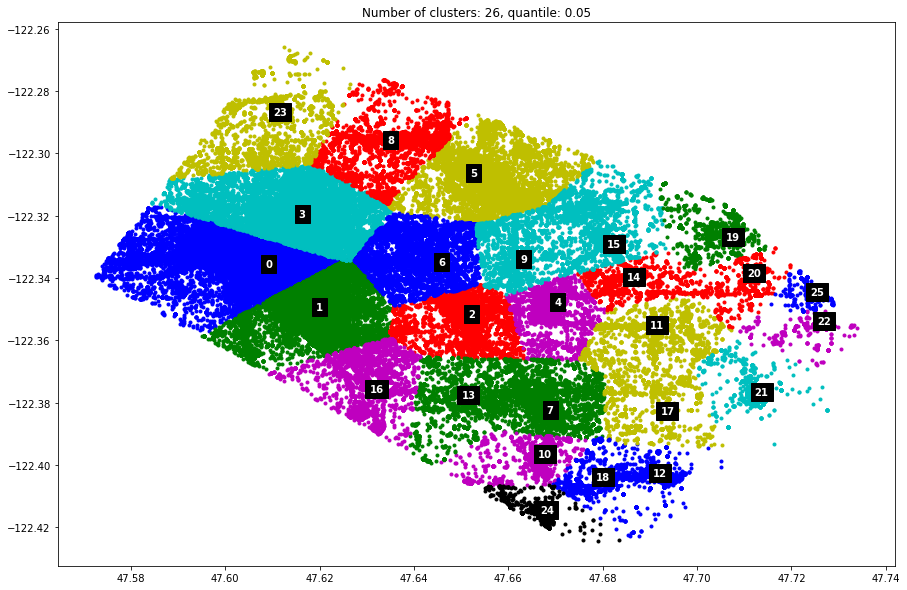

Silhouette Score : 0.4605555038691572
Cluster : 1, Number of images : 668


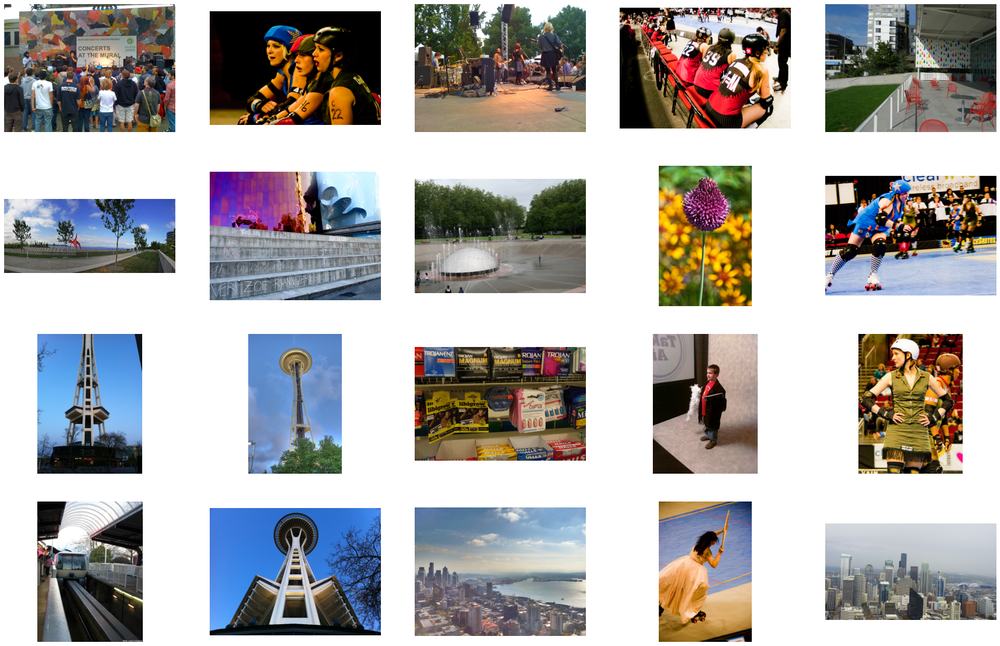

Cluster : 0, Number of images : 1619


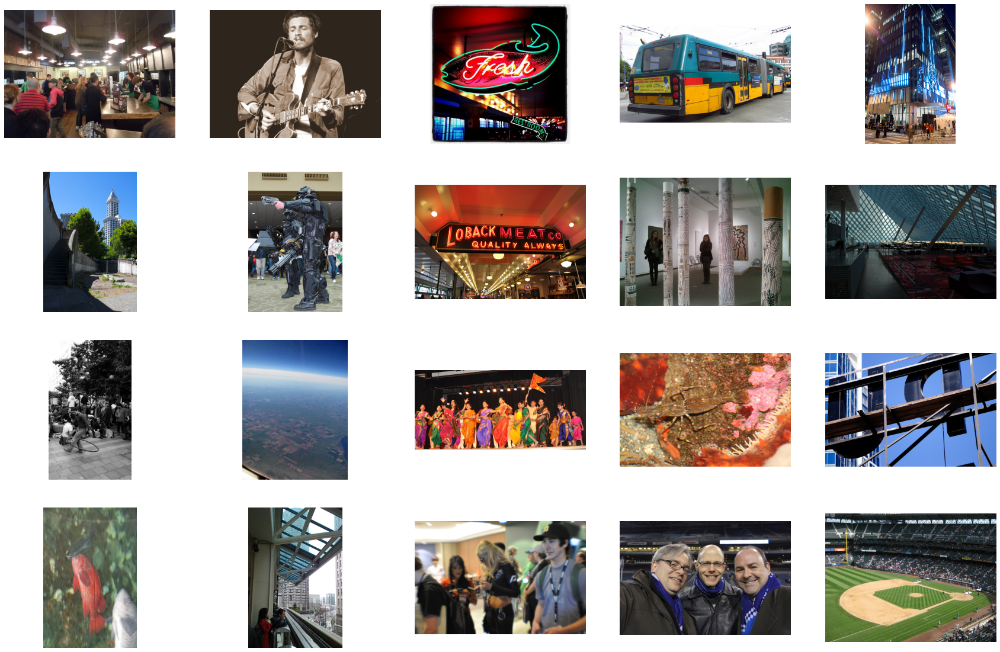

Cluster : 3, Number of images : 184


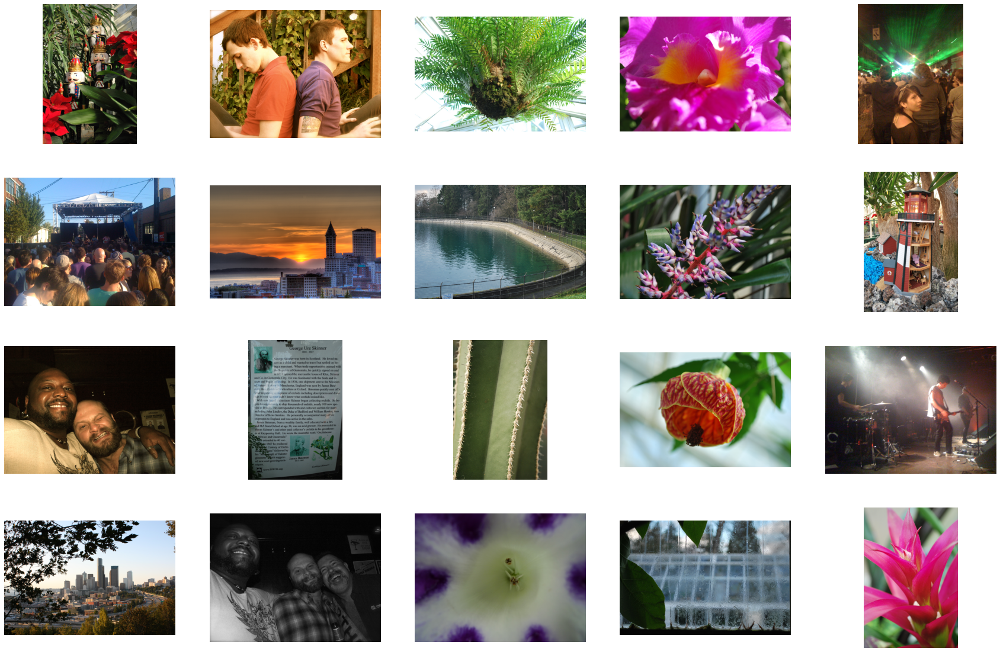

Cluster : 5, Number of images : 100


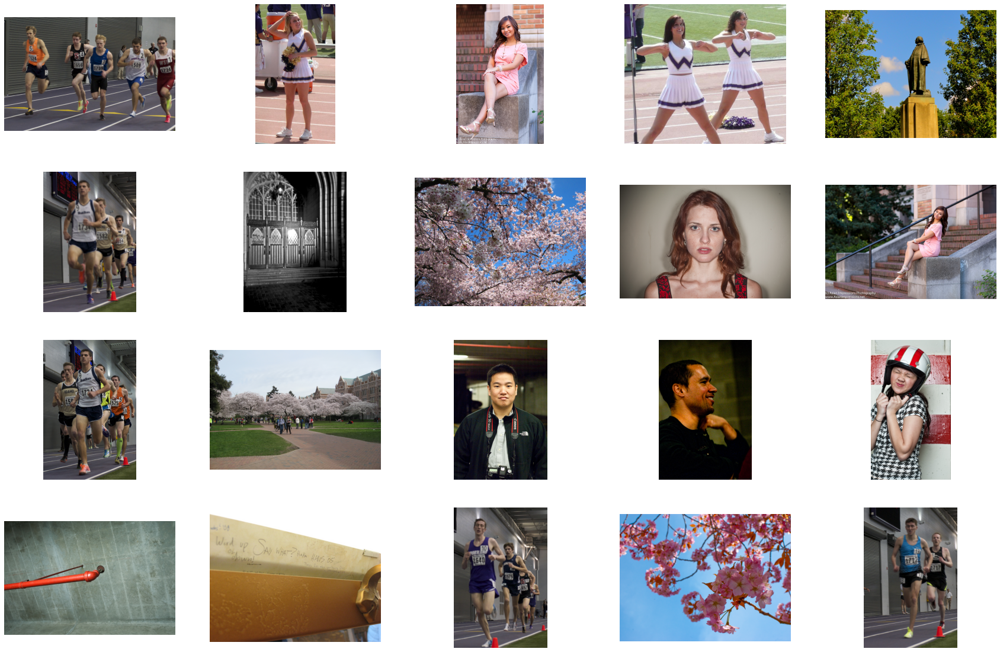

Cluster : 6, Number of images : 355


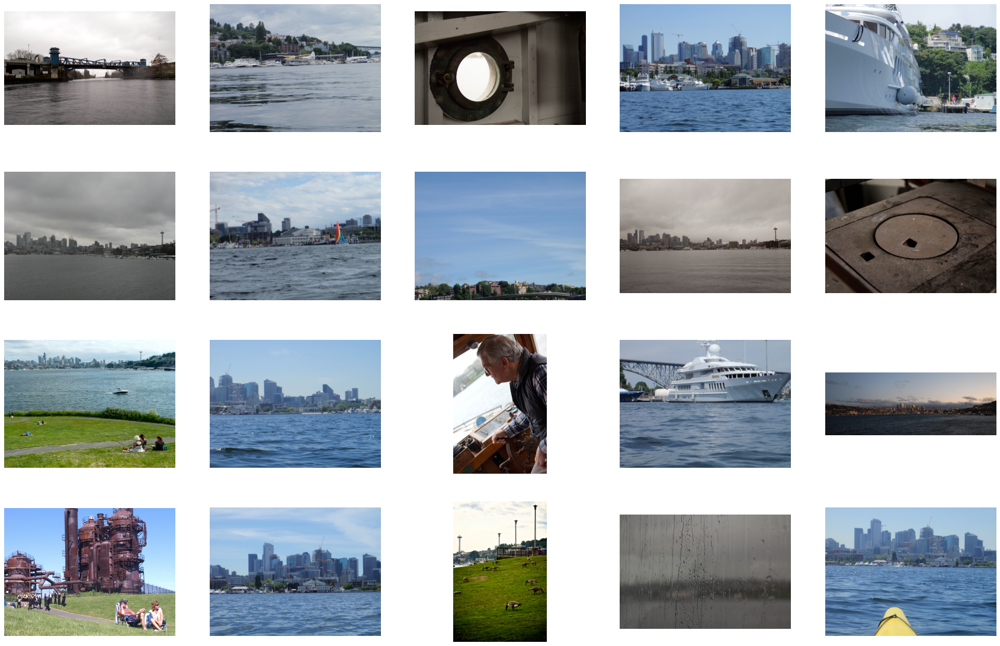

Cluster : 9, Number of images : 13


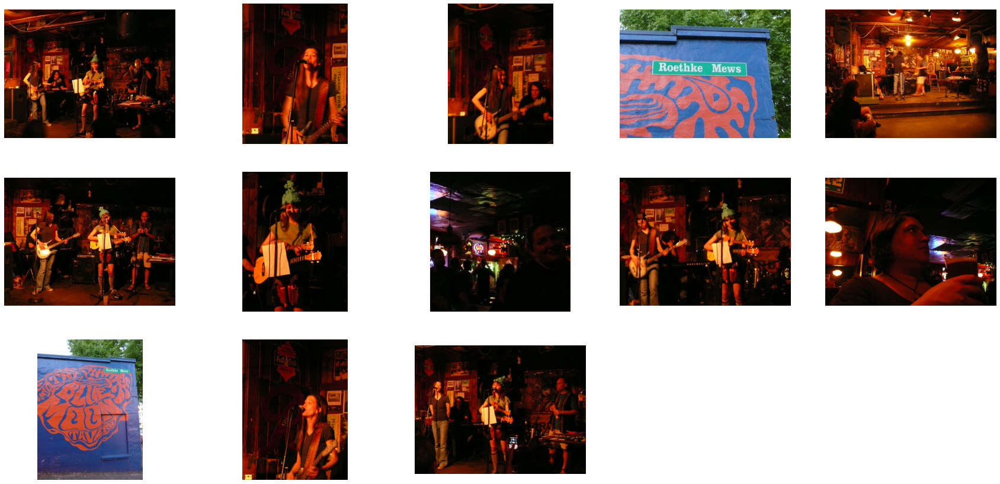

Cluster : 11, Number of images : 73


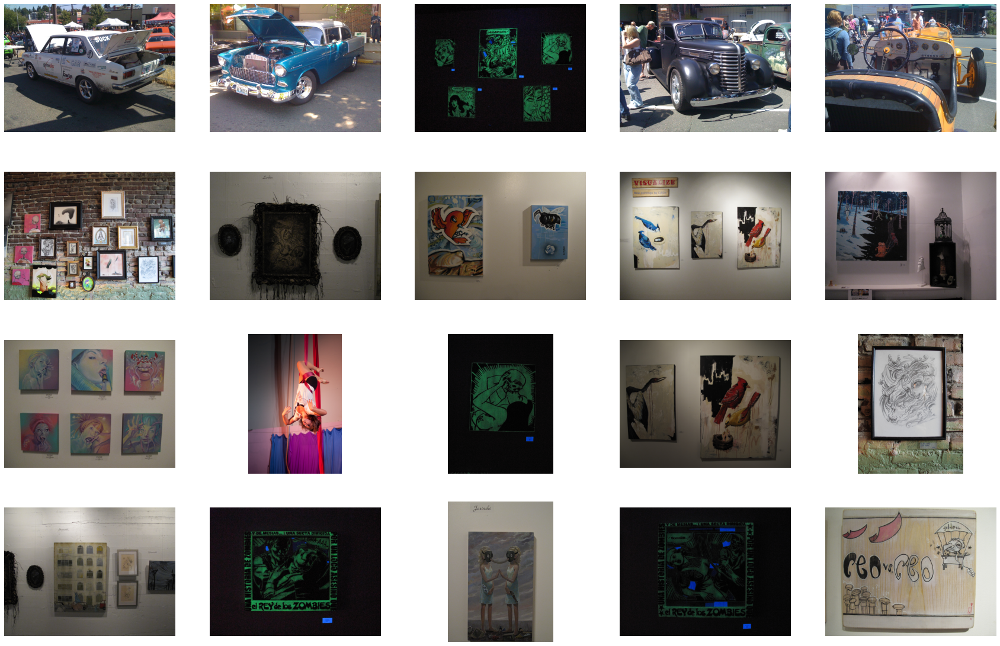

Cluster : 2, Number of images : 43


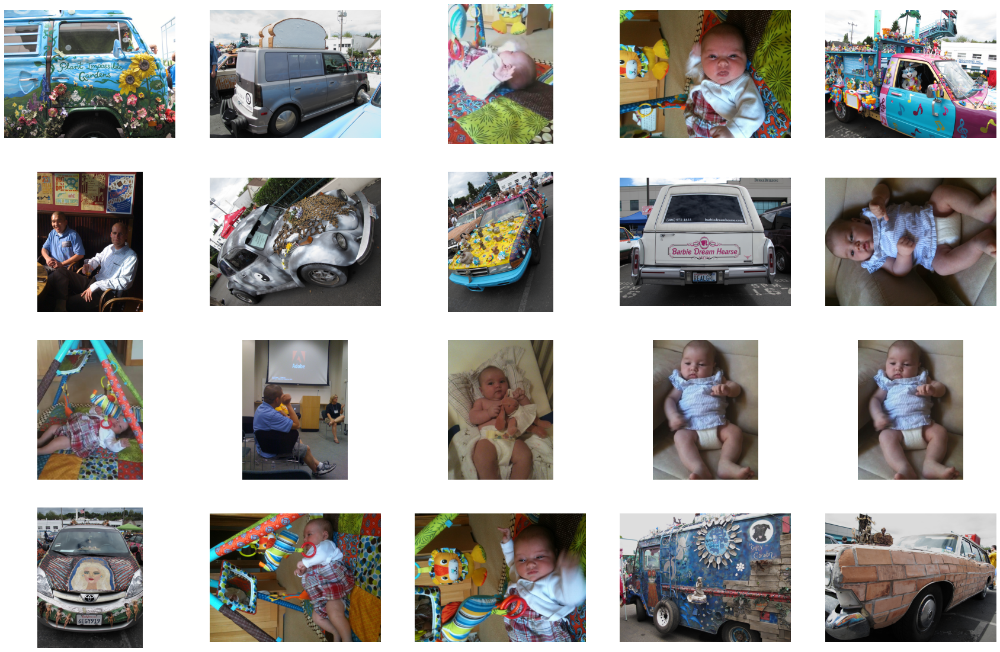

Cluster : 13, Number of images : 11


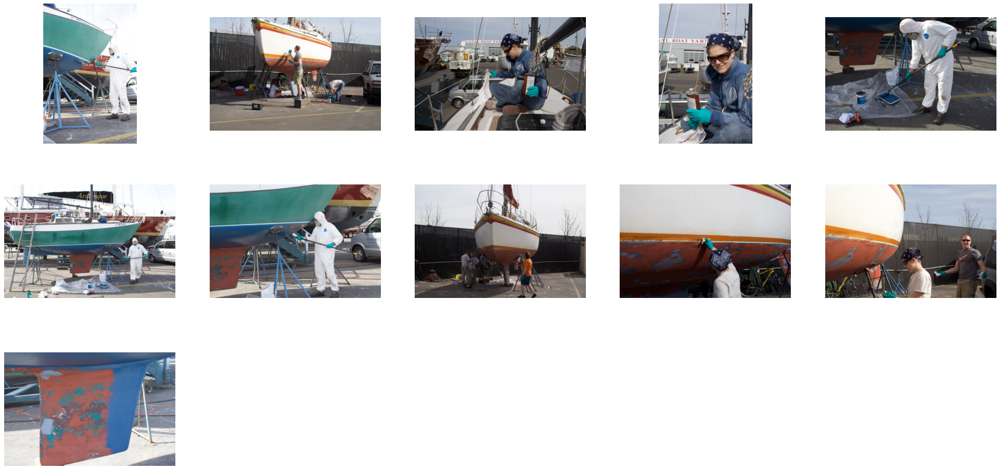

Cluster : 23, Number of images : 5


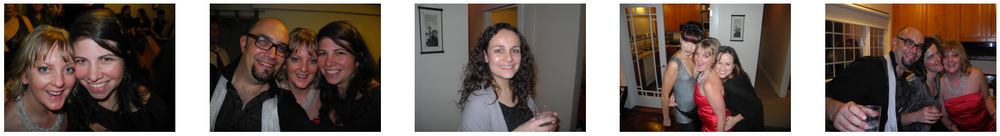

Cluster : 10, Number of images : 5


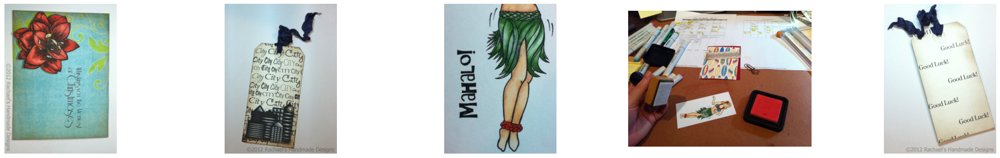

Cluster : 17, Number of images : 265


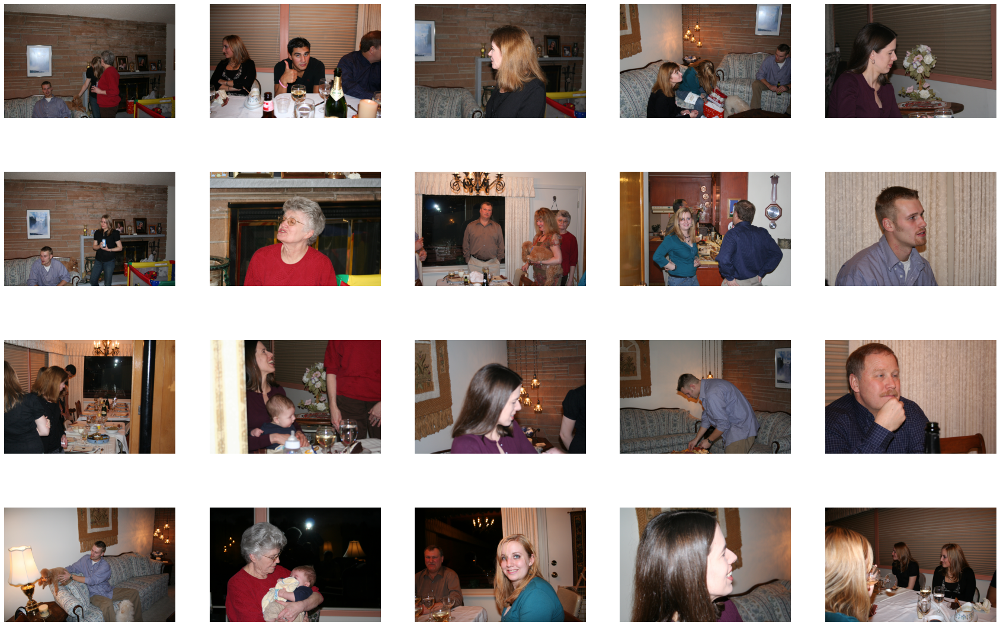

In [130]:
cluster, dataframe_csv = more_cluster([0], 0.05)

In [ ]:
num_file_list('0_0_0')

In [68]:
# save as csv
for i in range(num_clusters):
        tmp_dataframe_csv = dataframe_csv[dataframe_csv['cluster'] == i]
        tmp_dataframe_csv.to_csv(f"csv_result/0_0_0_{i}.csv", mode='w')

# copy photo as cluster structure
move_cluster('0_0_0', cluster)

In [ ]:
# phase 2
def sift(cluster_id):
    dir = f'geo_cluster/{cluster_id}'
    photofile_list = os.listdir(dir)
    sift_similarity = np.zeros((len(photofile_list), len(photofile_list)))

    for i in range(len(photofile_list)-1):
        for j in range(i+1, len(photofile_list)):
            img1 = cv2.imread(dir + '/' + photofile_list[i])
            img2 = cv2.imread(dir + '/' + photofile_list[j])
            gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
            gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

            # SIFT detector
            detector = cv2.xfeatures2d.SIFT_create()
            kp1, desc1 = detector.detectAndCompute(gray1, None)
            kp2, desc2 = detector.detectAndCompute(gray2, None)

            # BFMatcher
            matcher = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
            # calculate matching
            matches = matcher.match(desc1, desc2)
            # Use max for similarity
            sift_similarity[i,j] = max(len(matches)/len(kp1), len(matches)/len(kp2))
            sift_similarity[j,i] = sift_similarity[i,j]
    # Put photo id to array and save as csv
    photofile_list = [int(x[:-4]) for x in photofile_list]
    sift_similarity = np.insert(sift_similarity, 0, photofile_list, axis=0)
    np.savetxt(f'sift/{cluster_id}.csv', sift_similarity, delimiter=",")


In [ ]:
    
def flood_fill(cluster_id, threshold):
    # read sift result from csv file
    filename = f'sift/{cluster_id}.csv'
    dataset = np.loadtxt(filename, delimiter=',', dtype=np.float64)
    
    # data process to flood fill algorithm
    photo_id = dataset[0, :].astype(dtype=np.int64)
    num_photo = photo_id.shape[0]
    similarity_arr = dataset[1:, :]
    connnected_graph = np.where(similarity_arr > threshold, 1, 0)
    label = np.zeros(photo_id.shape).astype(dtype=np.int64)
    label.fill(-1)

    labeling_index = 0
    stack = []
    # Use dfs
    for i in range(num_photo):
        if label[i] != -1:
            continue
        stack.append(i)
        while(stack):
            node = stack.pop()
            # pass if labeled
            if label[node] != -1:
                continue
            label[node] = labeling_index
            for index, connect in enumerate(connnected_graph[node, :]):
                if connect == 1:
                    stack.append(index)
        labeling_index += 1
    
    photo_cluster = np.column_stack((photo_id, label))
    for i in range(labeling_index):
        photo_list = photo_cluster[photo_cluster[:, 1]==i][:, 0]
        print(f'Cluster : {i}, Number of images : {len(photo_list)}')
        fig = plt.figure(figsize=(30, 20))
        rows = 4
        columns = 5
        if len(photo_list) >=20:
            sample_img = np.random.choice(photo_list, 20, replace=False)
        else:
            sample_img = np.random.choice(photo_list, len(photo_list), replace=False)
        for j in range(len(sample_img)):
            tmp_img = cv.imread(f'./geo_cluster/{cluster_id}/{sample_img[j]}.jpg')
            fig.add_subplot(rows, columns, j+1)
            plt.axis('off')
            plt.imshow(cv.cvtColor(tmp_img, cv.COLOR_BGR2RGB))
        plt.show()

flood_fill('test', 0.625)

In [ ]:
# phase 2-2
def geo_flood_fill(cluster_id, k, threshold):
    # read sift result from csv file
    filename = f'sift/{cluster_id}.csv'
    dataset = np.loadtxt(filename, delimiter=',', dtype=np.float64)
    geo_dataset = pd.read_csv(f"csv_result/{cluster_id}.csv", header=0, index_col=0)
    
    # data process to flood fill algorithm
    photo_id = dataset[0, :].astype(dtype=np.int64)
    num_photo = photo_id.shape[0]

    distance_list = np.zeros((num_photo, num_photo))
    distance_list = distance_list.astype(np.float64)
    for i in range(num_photo-1):
        for j in range(i+1, num_photo):
            i_lat = geo_dataset[geo_dataset['photo_id'] == photo_id[i]]['latitude'].iloc[0]
            j_lat = geo_dataset[geo_dataset['photo_id'] == photo_id[j]]['latitude'].iloc[0]
            i_long = geo_dataset[geo_dataset['photo_id'] == photo_id[i]]['longitude'].iloc[0]
            j_long = geo_dataset[geo_dataset['photo_id'] == photo_id[j]]['longitude'].iloc[0]
            # get euclidean distance
            distance_list[i, j] = ((i_lat - j_lat)**2 + (i_long - j_long)**2)
            distance_list[j, i] = distance_list[i, j]
    tmp_distance_list = np.max(distance_list) - distance_list
    # use min-max normalization
    norm_distance_inverse_list = (tmp_distance_list - np.min(tmp_distance_list))/(np.max(tmp_distance_list)-np.min(tmp_distance_list))
    similarity_arr = dataset[1:, :]
    # combine geo feature and visual feature with coefficent k
    geo_similar_arr = k * norm_distance_inverse_list + (k-1) * similarity_arr
    connnected_graph = np.where(geo_similar_arr > threshold, 1, 0)
    
    label = np.zeros(photo_id.shape).astype(dtype=np.int64)
    label.fill(-1)

    labeling_index = 0
    stack = []
    # Use dfs
    for i in range(num_photo):
        if label[i] != -1:
            continue
        stack.append(i)
        while(stack):
            node = stack.pop()
            # pass if labeled
            if label[node] != -1:
                continue
            label[node] = labeling_index
            for index, connect in enumerate(connnected_graph[node, :]):
                if connect == 1:
                    stack.append(index)
        labeling_index += 1
    
    photo_cluster = np.column_stack((photo_id, label))
    for i in range(labeling_index):
        photo_list = photo_cluster[photo_cluster[:, 1]==i][:, 0]
        print(f'Cluster : {i}, Number of images : {len(photo_list)}')
        fig = plt.figure(figsize=(30, 20))
        rows = 4
        columns = 5
        if len(photo_list) >=20:
            sample_img = np.random.choice(photo_list, 20, replace=False)
        else:
            sample_img = np.random.choice(photo_list, len(photo_list), replace=False)
        for j in range(len(sample_img)):
            tmp_img = cv.imread(f'./geo_cluster/{cluster_id}/{sample_img[j]}.jpg')
            fig.add_subplot(rows, columns, j+1)
            plt.axis('off')
            plt.imshow(cv.cvtColor(tmp_img, cv.COLOR_BGR2RGB))
        plt.show()

geo_flood_fill('0_0_0_0', 0.7, 0.615)

In [ ]:
def make_graph(cluster_id, k):
    # read sift result from csv file
    filename = f'sift_result/{cluster_id}.csv'
    dataset = np.loadtxt(filename, delimiter=',', dtype=np.int64)
    
    # data process to flood fill algorithm
    photo_id = dataset[0, :].astype(dtype=np.int64)
    num_photo = photo_id.shape[0]
    similarity_arr = dataset[1:, :]
    threshold = np.mean(similarity_arr) + k*np.std(similarity_arr)
    connnected_graph = np.where(similarity_arr > threshold, 1, 0)
    label = np.zeros(photo_id.shape).astype(dtype=np.int64)
    label.fill(-1)

    labeling_index = 0
    stack = []
    # Use dfs
    for i in range(num_photo):
        if label[i] != -1:
            continue
        stack.append(i)
        while(stack):
            node = stack.pop()
            # pass if labeled
            if label[node] != -1:
                continue
            label[node] = labeling_index
            for index, connect in enumerate(connnected_graph[node, :]):
                if connect == 1:
                    stack.append(index)
        labeling_index += 1
    
    photo_cluster = np.column_stack((photo_id, label))
    for i in range(labeling_index):
        photo_list = photo_cluster[photo_cluster[:, 1]==i][:, 0]
        print(f'Cluster : {i}, Number of images : {len(photo_list)}')
        fig = plt.figure(figsize=(30, 20))
        rows = 4
        columns = 5
        if len(photo_list) >=20:
            sample_img = np.random.choice(photo_list, 20, replace=False)
        else:
            sample_img = np.random.choice(photo_list, len(photo_list), replace=False)
        for j in range(len(sample_img)):
            tmp_img = cv.imread(f'./geo_cluster/{cluster_id}/{sample_img[j]}.jpg')
            fig.add_subplot(rows, columns, j+1)
            plt.axis('off')
            plt.imshow(cv.cvtColor(tmp_img, cv.COLOR_BGR2RGB))
        plt.show()    

make_graph('3', -0.5)

In [ ]:
# Phase 3
# get list of tag == seattle

tags = pd.read_csv('./Tag.csv', header=0, names= ['photo_id', 'tag_id', 'tag'])
photo_id_tag = np.array(tags[tags['tag'] == 'seattle']['photo_id'].astype(str))

for id in photo_id_tag:
    fig = plt.figure(figsize=(15, 10))
    rows = 4
    columns = 5
    if len(value) >=20:
        sample_img = np.random.choice(value, 20, replace=False)
    else:
        sample_img = np.random.choice(value, len(value), replace=False)
    for i in range(len(sample_img)):
        tmp_img = cv.imread('./Photos/' + sample_img[i] + '.jpg')
        fig.add_subplot(rows, columns, i+1)
        plt.axis('off')
        plt.imshow(cv.cvtColor(tmp_img, cv.COLOR_BGR2RGB))
    plt.show()

In [195]:
stop_word = ['seattle', 'washington', 'usa', 'wa', 'iphoneography', 'instagramapp', 'unitedstates']

photo_id_tag_list = {}
for index, row in tags.iterrows():
    photo_id = row['photo_id']
    tag = str(row['tag'])
    # if tag contain =, : or only with number, delete
    if '=' in tag:
        continue
    if ':' in tag:
        continue
    if tag.isdigit():
        continue
    if tag in stop_word:
        continue
    
    if photo_id in photo_id_tag_list:
        photo_id_tag_list[photo_id].append(tag)
    else:
        photo_id_tag_list[photo_id] = [tag]

tag_sentense_list = []
for key, value in photo_id_tag_list.items():
    tag_sentense_list.append(' '.join(value))


normalized_text = []
for string in tag_sentense_list:
    tokens = string.lower()
    normalized_text.append(tokens)

tag_sentense = [word_tokenize(sentence) for sentence in normalized_text]

model = Word2Vec(sentences=tag_sentense, window=1000000, min_count=3, workers=12, sg=0)



In [ ]:
model_result = model.wv.most_similar("seattle")
print(model_result)

In [193]:
def tag_clustering(cluster_id):

    path_photos = f'./geo_cluster/{cluster_id}/'
    photofile_list = os.listdir(path_photos)
    photo_id_list = []
    for photofile in photofile_list:
        photo_id_list.append(photofile[:-4])
    num_photos = len(photo_id_list)

    tag_similar = np.zeros((num_photos, num_photos))


    for i in range(num_photos-1):
        for j in range(i+1, num_photos):
            int
            if int(photo_id_list[i]) in photo_id_tag_list and int(photo_id_list[j]) in photo_id_tag_list:
                tag_similar[i, j] = model.wv.n_similarity(photo_id_tag_list[int(photo_id_list[i])], photo_id_tag_list[int(photo_id_list[j])])
                tag_similar[j, i] = tag_similar[i, j]

    np.savetxt(f'tag_result/{cluster_id}.csv', tag_similar, delimiter=",")

tag_clustering('0_0_0_0')


In [250]:
def text_similarity(cluster_id1, cluster_id2):
    # calculate two clusters similarity based on textual feature
    path_photos_1 = f'./final_cluster/{cluster_id1}/'
    path_photos_2 = f'./final_cluster/{cluster_id2}/'
    photofile_list_1 = os.listdir(path_photos_1)
    photofile_list_2 = os.listdir(path_photos_2)
    photo_id_list_1 = []
    photo_id_list_2 = []
    for photofile in photofile_list_1:
        photo_id_list_1.append(photofile[:-4])
    for photofile in photofile_list_2:
        photo_id_list_2.append(photofile[:-4])
    
    tag_list_1 = []
    for id in photo_id_list_1:
        if int(id) in photo_id_tag_list:
            tag_list_1.extend(photo_id_tag_list[int(id)])

    tag_list_2 = []
    for id in photo_id_list_2:
        if int(id) in photo_id_tag_list:
            tag_list_2.extend(photo_id_tag_list[int(id)])
    similarity = model.wv.n_similarity(tag_list_1, tag_list_2)
    return similarity

def text_clustering(threshold):
    path = f'./final_cluster/'
    cluster_ids = os.listdir(path)
    num_cluster = len(cluster_ids)
    cluster_merge = np.zeros((num_cluster, num_cluster))
    # get pairwise similarity matrix
    for i in range(num_cluster-1):
        for j in range(i+1, num_cluster):
            cluster_merge[i, j] = text_similarity(cluster_ids[i], cluster_ids[j])
            cluster_merge[j, i] = cluster_merge[i, j]
    
    connnected_graph = np.where(cluster_merge > threshold, 1, 0)
    label = np.zeros(num_cluster).astype(dtype=np.int64)
    label.fill(-1)

    labeling_index = 0
    stack = []
    # Use dfs
    for i in range(num_cluster):
        if label[i] != -1:
            continue
        stack.append(i)
        while(stack):
            node = stack.pop()
            # pass if labeled
            if label[node] != -1:
                continue
            label[node] = labeling_index
            for index, connect in enumerate(connnected_graph[node, :]):
                if connect == 1:
                    stack.append(index)
        labeling_index += 1
    merged_cluster = np.column_stack((cluster_ids, label))

    for i in range(labeling_index):
        merged_list = merged_cluster[merged_cluster[:, 1]==str(i)][:, 0]
        print(f'Cluster : {i}, Number of images : {len(merged_list)}')
        print(merged_list)

    return merged_cluster, labeling_index

merged_cluster, labeling_index = text_clustering(0.98)



Cluster : 0, Number of images : 4
['0_0_0_0' '0_0_0_11' '0_0_0_3' '0_0_2_3']
Cluster : 1, Number of images : 1
['0_0_0_1']
Cluster : 2, Number of images : 1
['0_0_0_13']
Cluster : 3, Number of images : 3
['0_0_0_2' '0_0_1_2' '6_9']
Cluster : 4, Number of images : 25
['0_0_0_4' '0_0_0_9' '0_0_11' '0_0_1_0' '0_0_1_4' '0_0_21' '0_0_2_1'
 '0_0_2_4' '0_0_6' '0_10' '0_1_5' '0_3_3' '0_3_6' '0_5_2' '0_5_5' '0_6_10'
 '0_9' '11_1' '16' '1_2' '1_3' '5_4' '7_10' '7_11' '8']
Cluster : 5, Number of images : 1
['0_0_0_6']
Cluster : 6, Number of images : 5
['0_0_0_7' '0_0_7' '0_1_3' '0_6_0' '1_5']
Cluster : 7, Number of images : 1
['0_0_0_8']
Cluster : 8, Number of images : 1
['0_0_10']
Cluster : 9, Number of images : 1
['0_0_17']
Cluster : 10, Number of images : 2
['0_0_1_1' '0_0_2_6']
Cluster : 11, Number of images : 1
['0_0_2_0']
Cluster : 12, Number of images : 1
['0_0_2_2']
Cluster : 13, Number of images : 1
['0_0_2_9']
Cluster : 14, Number of images : 1
['0_0_3']
Cluster : 15, Number of images :

In [220]:
# get merged cluster data and copy photos as cluster structure
def merge_clustering(merged_cluster, labeling_index):
    for i in range(labeling_index):
        merged_list = merged_cluster[merged_cluster[:, 1]==str(i)][:, 0]
        for id in merged_list:
            copy_dir = f'./result_cluster/new{i}'
            if not os.path.isdir(copy_dir):
                os.makedirs(copy_dir)
            tmp_path = f'./final_cluster/{id}/'
            photo_id_list = os.listdir(tmp_path)
            for photo_id in photo_id_list:
                shutil.copy(f'./final_cluster/{id}/{photo_id}', f'{copy_dir}/{photo_id}')

merge_clustering(merged_cluster, labeling_index)

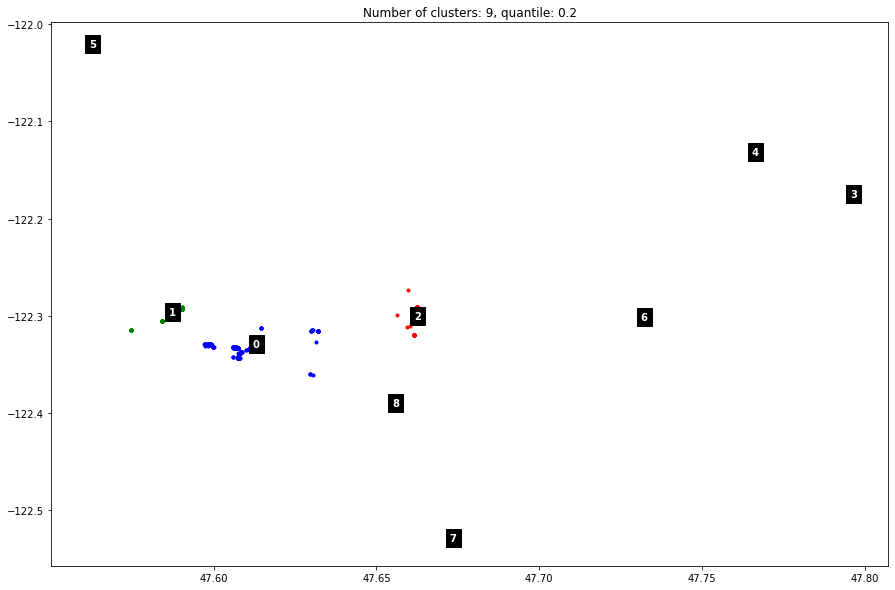

In [246]:
# last step of clustering. after textual clustering, do geo clustering
def result_geo(cluster_id):
    photos = pd.read_csv('./Photo.csv', header=0, names= ['photo_id', 'user_id', 'latitude', 'longitude', 'time', 'etc'])
    dataframe = pd.DataFrame(photos)
    photo_id_list = []
    path_photos = f'./result_cluster/{cluster_id}/'
    photofile_list = os.listdir(path_photos)
    for photofile in photofile_list:
        photo_id_list.append(photofile[:-4])

    result_dataframe = pd.DataFrame()
    for id in photo_id_list:
        result_dataframe = pd.concat([result_dataframe, dataframe[dataframe['photo_id'] == int(id)][['latitude', 'longitude']]])
    
    quantile = 0.2
    bandwidth = estimate_bandwidth(result_dataframe, quantile=quantile, n_samples=1000, n_jobs=-1)
    cluster = MeanShift(bandwidth = bandwidth, bin_seeding=True, n_jobs = -1).fit(result_dataframe)

    labels = cluster.labels_
    cluster_centers = cluster.cluster_centers_

    labels_unique = np.unique(labels)
    num_clusters = len(labels_unique) - 1
    plt.figure(figsize=(15, 10))
    plt.clf()
    colors = cycle('bgrcmkybgrcmykbgrcmybgrcmyk')
    for k, col in zip(range(num_clusters), colors):
        my_members = labels == k
        cluster_center = cluster_centers[k]
        plt.plot(result_dataframe['latitude'][my_members], result_dataframe['longitude'][my_members], col + '.')
        plt.annotate(k, xy=(cluster_center[0], cluster_center[1]), color='white', backgroundcolor=(0.0, 0.0, 0.0), size=10, weight='bold') # annotate each cluster
    plt.title(f'Number of clusters: {num_clusters}, quantile: {quantile}')
    plt.show()

    for i in range(len(photo_id_list)):
        id = photo_id_list[i]
        label = labels[i]
        copy_dir = f'./result_cluster/{cluster_id}_{label}'
        if not os.path.isdir(copy_dir):
            os.makedirs(copy_dir)
        shutil.copy(f'./result_cluster/{cluster_id}/{id}.jpg', f'{copy_dir}/{id}.jpg')

result_geo('new4')